<a href="https://colab.research.google.com/github/cykim8811/SoundQuality/blob/main/SQF1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Sound Quality Improvement
 This projects aims to create a neural network model that makes the sound output from a speaker similar to the sound from a real sound source.

Project Settings

In [ ]:
n_fft = 512

## Preprocessing

### 1. Load Data

#### 1.1 Import modules, mount google drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: ignored

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout
from tensorflow.keras.layers import BatchNormalization, Activation, ZeroPadding2D
from tensorflow.keras.layers import LeakyReLU, MaxPooling2D
from tensorflow.keras.layers import UpSampling2D, Conv2D, Conv2DTranspose
from tensorflow.keras.layers import Conv1D
from tensorflow.keras.models import Sequential, Model

import librosa
from drive.MyDrive.DeepLearning.Tools.soundmanager import *
import matplotlib.pyplot as plt
from IPython.display import clear_output

#### 1.2 Load sound data from files

In [ ]:
sd1 = SoundData.loadFromFile("drive/MyDrive/DeepLearning/Dataset/Blueming_IU.mp3", n_fft=n_fft).sample_by_stft_index(300, None)
sd2 = SoundData.loadFromFile("drive/MyDrive/DeepLearning/Dataset/MS_Blueming_IU.m4a", n_fft=n_fft).sample_by_stft_index(300, None)
sd1.play()
sd2.play()

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


### 2. Synchronize Sound Datas

#### 2.1 Rough initial synchronization

Synchronize by fourier transformed amplitudes



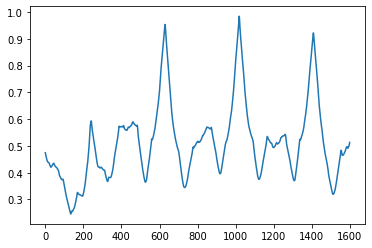

Offset: 219

Sound Data 1:


Sound Data 2:



Sound Datas Combined:


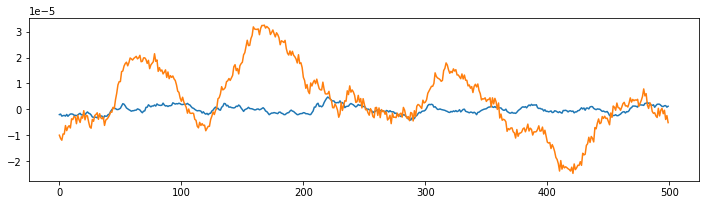

In [ ]:
print("Synchronize by fourier transformed amplitudes\n")
offset = synchronize_by_amp(sd1, sd2, 800, 800)
print(f"Offset: {offset}\n")

# Check the sound datas
print("Sound Data 1:")
sd1.play()
print("Sound Data 2:")
sd2.play()

# Combined sound for test
print("\nSound Datas Combined:")
sd_combined = SoundData(sd1.fr)
sd_combined.raw = sd1.raw + sd2.raw
sd_combined.play()

# Check sound wave
plt.figure(figsize=(12, 3))
sd1.plot(13700, 500)
sd2.plot(13700, 500)
plt.show()

Synchronize by sound wave datas



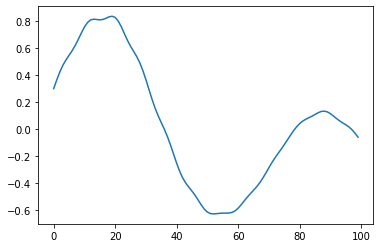

Offset: -31

SD1 + SD2


SD1 - SD2


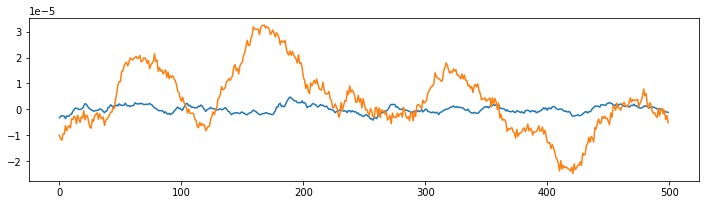

In [ ]:
print("Synchronize by sound wave datas\n")
offset = synchronize_by_raw(sd1, sd2, 50, 800)
print(f"Offset: {offset}\n")

# Combined sound for test
print("SD1 + SD2")
sd_combined = SoundData(sd1.fr)
sd_combined.raw = sd1.raw + sd2.raw
sd_combined.play()

print("SD1 - SD2")
sd_combined = SoundData(sd1.fr)
sd_combined.raw = sd1.raw - sd2.raw
sd_combined.play()

# Check sound wave
plt.figure(figsize=(12, 3))
sd1.plot(13700, 500)
sd2.plot(13700, 500)
plt.show()

#### 2.2 Slice datas into pieces

In [ ]:
chunk_size = 5000
sample_length = 80000 # Sample size for comparing

In [ ]:
sd1_chunks = []
sd2_chunks = []
sd1_index_log = []
sd2_index_log = []
sd1_index = sample_length
sd2_index = sample_length
offset_log = []
while sd1_index + max(chunk_size, sample_length/2) < sd1.raw.shape[0] and sd2_index + max(chunk_size, sample_length/2) < sd2.raw.shape[0]:
  clear_output(wait=True)
  offset, similarity = synchronize_by_raw_opt(sd1.raw[sd1_index-round(sample_length/2):sd1_index+round(sample_length/2)+4], sd2.raw[sd2_index-round(sample_length/2):sd2_index+round(sample_length/2)+4], 4, sample_length)
  print("offset", offset, "similarity", similarity)
  offset_log.append(offset)
  if len(offset_log) > 4 and all([t==offset for t in offset_log[-2:-1]]):
    print("Update Offset")
    if offset > 0:
      sd2_index += offset
    else:
      sd1_index += -offset
  print(f"{round(100*sd1_index/sd1.raw.shape[0])}%")
  
  sd1_index_log.append(sd1_index)
  sd2_index_log.append(sd2_index)

  if similarity > 0.2:
    sd1_chunks.append(sd1.sample_by_raw_index(sd1_index, sd1_index+chunk_size).amp)
    sd2_chunks.append(sd2.sample_by_raw_index(sd2_index, sd2_index+chunk_size).amp)

  sd1_index += chunk_size
  sd2_index += chunk_size


In [ ]:
# Index
plt.figure(figsize=(12, 3))
plt.subplot(1, 2, 1)
plt.plot(sd1_index_log)
plt.plot(sd2_index_log)
plt.subplot(1, 2, 2)
plt.plot(offset_log)
plt.show()

In [ ]:
data1 = np.array(sd1_chunks)
data2 = np.array(sd2_chunks)
print(data1.shape, data2.shape)

In [ ]:
ind = 230
ipd.display(ipd.Audio(sd1_chunks[ind], rate=sd1.fr))
ipd.display(ipd.Audio(sd2_chunks[ind], rate=sd1.fr))
ipd.display(ipd.Audio(sd1_chunks[ind] - sd2_chunks[ind], rate=sd1.fr))
ipd.display(ipd.Audio(sd1_chunks[ind] + sd2_chunks[ind], rate=sd1.fr))
plt.figure(figsize=(18, 3))
plt.plot(sd1_chunks[ind][:300])
plt.plot(sd2_chunks[ind][:300])
plt.show()

## Build Model

In [ ]:
def build_T():
    x_input = Input(shape = (None, 1))
    x = x_input

    for i in [3, 3, 5, 5, 5, 9, 9, 15, 15, 20, 20]:
      x = Conv1D(128, 3, padding='same')(x)
      x = LeakyReLU(0.3)(x)
    
    for i in [512, 256, 256, 256, 64, 64, 1]:
      x = Dense(i)(x)
      x = LeakyReLU(0.3)(x)
    
    model = Model(x_input, x, name="T")
    return model

In [ ]:
adamopt = keras.optimizers.Adam(0.0000005, 0.5)
T = build_T()
T.compile(loss="mse", optimizer=adamopt)
T.summary()

In [ ]:
history = T.fit(data2, data1, epochs=10000, batch_size=32)
clear_output()
plt.plot(history.history['loss'])
plt.show()

Epoch 1/10000
9/9 [==============================] - 2s 186ms/step - loss: 1.6951e-07
Epoch 2/10000
9/9 [==============================] - 2s 186ms/step - loss: 1.6659e-07
Epoch 3/10000
9/9 [==============================] - 2s 185ms/step - loss: 1.6645e-07
Epoch 4/10000
9/9 [==============================] - 2s 185ms/step - loss: 1.6658e-07
Epoch 5/10000
9/9 [==============================] - 2s 184ms/step - loss: 1.6631e-07
Epoch 6/10000
9/9 [==============================] - 2s 186ms/step - loss: 1.6659e-07
Epoch 7/10000
9/9 [==============================] - 2s 185ms/step - loss: 1.6629e-07
Epoch 8/10000
9/9 [==============================] - 2s 185ms/step - loss: 1.6630e-07
Epoch 9/10000
9/9 [==============================] - 2s 184ms/step - loss: 1.6679e-07
Epoch 10/10000
9/9 [==============================] - 2s 184ms/step - loss: 1.6622e-07
Epoch 11/10000
9/9 [==============================] - 2s 186ms/step - loss: 1.6645e-07
Epoch 12/10000
9/9 [==============================] 

KeyboardInterrupt: ignored

SD1


SD2


pred(SD2)


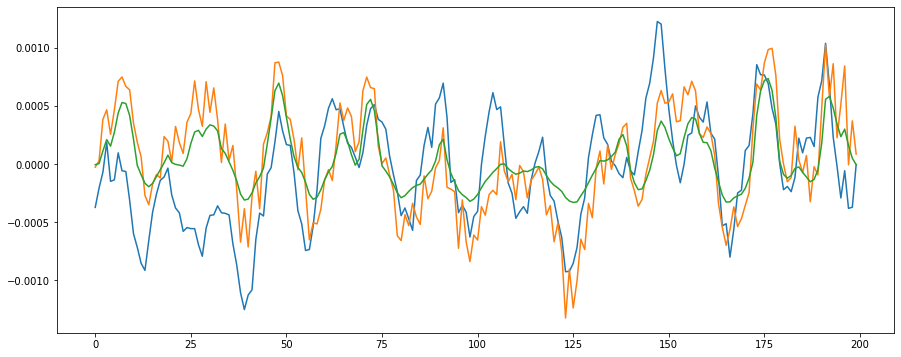

In [ ]:
ind = 180

result = T.predict(data2[ind].reshape((1, -1))).flatten()

print("SD1")
ipd.display(ipd.Audio(data1[ind], rate=sd1.fr))
print("SD2")
ipd.display(ipd.Audio(data2[ind], rate=sd1.fr))
print("pred(SD2)")
ipd.display(ipd.Audio(result, rate=sd1.fr))

plt.figure(figsize=(15, 6))
plt.plot(data1[ind][:200])
plt.plot(data2[ind][:200])
plt.plot(result[:200])
plt.show()